In [ ]:
import os
import numpy as np
from skimage import io
from tensorflow.keras.models import Model
from sklearn.model_selection import train_test_split


def load_images_from_folder(folder, max_images=None):
    images = []
    img_list = os.listdir(folder)
    img_list.sort()
    count = 0
    for filename in img_list:
        if max_images is not None and count >= max_images:
            break
        img = io.imread(os.path.join(folder, filename))
        img = img / 255.0  # Normalize to [0, 1]
        images.append(img)
        count += 1
    return images

def concatenate_images(before, after):
    concatenated = []
    for b, a in zip(before, after):
        concatenated.append(np.dstack((b, a)))  # Stack along the channel dimension
    return concatenated

# Define the total number of images to load for both train and test sets
total_train_images = 100
total_test_images = 60

# Load train set images
S2_train_before = load_images_from_folder('/content/drive/MyDrive/OmbriaS2/train/BEFORE', max_images=total_train_images)
S2_train_after = load_images_from_folder('/content/drive/MyDrive/OmbriaS2/train/AFTER', max_images=total_train_images)
S2_train_mask = load_images_from_folder('/content/drive/MyDrive/OmbriaS2/train/MASK', max_images=total_train_images)

# Load test set images
S2_test_before = load_images_from_folder('/content/drive/MyDrive/OmbriaS2/test/BEFORE', max_images=total_test_images)
S2_test_after = load_images_from_folder('/content/drive/MyDrive/OmbriaS2/test/AFTER', max_images=total_test_images)
S2_test_mask = load_images_from_folder('/content/drive/MyDrive/OmbriaS2/test/MASK', max_images=total_test_images)

# Concatenate 'before' and 'after' images for train and test sets
X_train_full = concatenate_images(S2_train_before, S2_train_after)
Y_train_full = S2_train_mask

X_test_full = concatenate_images(S2_test_before, S2_test_after)
Y_test_full = S2_test_mask

# Ensure masks have the correct shape (256, 256, 1)
Y_train_full = [np.expand_dims(mask, axis=-1) for mask in Y_train_full]
Y_test_full = [np.expand_dims(mask, axis=-1) for mask in Y_test_full]

# Convert lists to numpy arrays
X_train_full = np.array(X_train_full)
Y_train_full = np.array(Y_train_full)

X_test_full = np.array(X_test_full)
Y_test_full = np.array(Y_test_full)




In [ ]:
# Split data into training and validation sets from the training set
X_train, X_val, Y_train, Y_val = train_test_split(X_train_full, Y_train_full, test_size=0.4, random_state=42)

# Print the shapes of individual images and masks for verification
print("X_train shape:", X_train.shape)
print("Y_train shape:", Y_train.shape)
print("X_val shape:", X_val.shape)
print("Y_val shape:", Y_val.shape)
print("X_test shape:", X_test_full.shape)
print("Y_test shape:", Y_test_full.shape)

X_train shape: (60, 256, 256, 6)
Y_train shape: (60, 256, 256, 1)
X_val shape: (40, 256, 256, 6)
Y_val shape: (40, 256, 256, 1)
X_test shape: (60, 256, 256, 6)
Y_test shape: (60, 256, 256, 1)


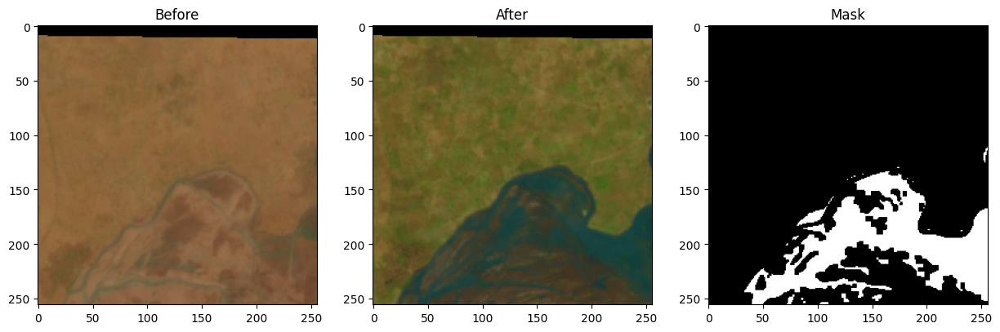

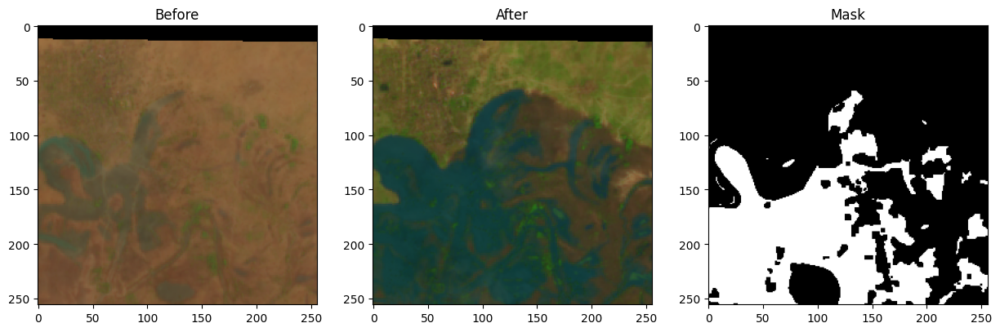

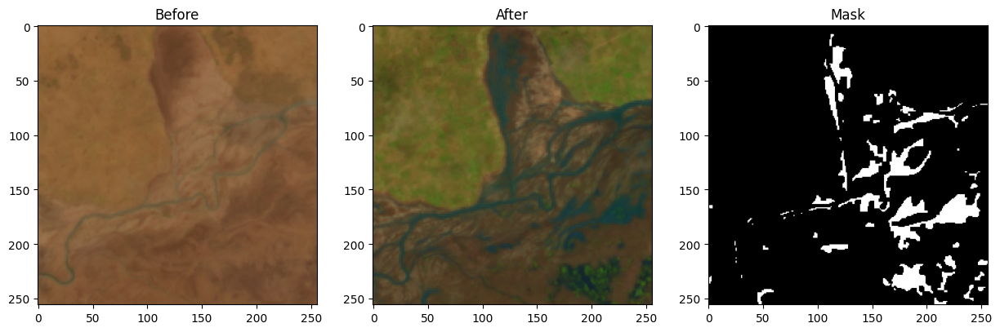

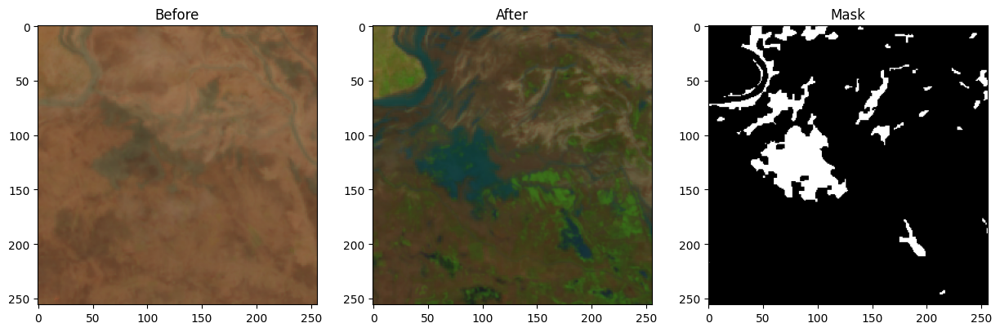

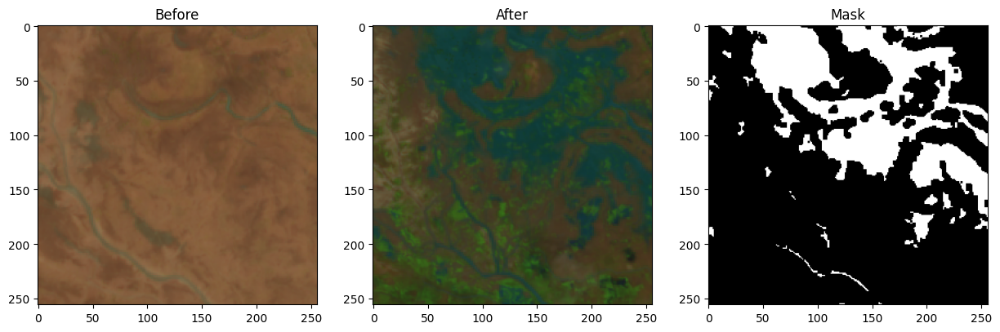

In [ ]:
import matplotlib.pyplot as plt

def display_images(before, after, mask, index):
    plt.figure(figsize=(15, 5))

    # Display 'before' image
    plt.subplot(1, 3, 1)
    plt.imshow(before[index])
    plt.title('Before')

    # Display 'after' image
    plt.subplot(1, 3, 2)
    plt.imshow(after[index])
    plt.title('After')

    # Display mask image
    plt.subplot(1, 3, 3)
    plt.imshow(mask[index], cmap='gray')
    plt.title('Mask')

    plt.show()

# Display a few images from the training set
for i in range(5):  # Change the range to display more images+
    display_images(S2_train_before, S2_train_after, S2_train_mask, i)


In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, Dropout, LeakyReLU
from tensorflow.keras.models import Model
from tensorflow.keras.metrics import MeanIoU
from tensorflow.keras.callbacks import TensorBoard, EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import datetime

%matplotlib inline
%load_ext tensorboard

def dice_coefficient(y_true, y_pred):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    return (2. * intersection) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + tf.keras.backend.epsilon())

# Initialize the metrics outside the tf.function context
precision_metric = tf.keras.metrics.Precision()
recall_metric = tf.keras.metrics.Recall()

def custom_precision(y_true, y_pred):
    threshold = 0.5
    y_pred = tf.cast(y_pred > threshold, tf.float32)
    return precision_metric(y_true, y_pred)

def custom_recall(y_true, y_pred):
    threshold = 0.5
    y_pred = tf.cast(y_pred > threshold, tf.float32)
    return recall_metric(y_true, y_pred)

def unet(input_size=(256, 256, 6)):
    inputs = Input(input_size)
    conv1 = Conv2D(64, 3, activation=LeakyReLU(), padding='same')(inputs)
    conv1 = Conv2D(64, 3, activation=LeakyReLU(), padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation=LeakyReLU(), padding='same')(pool1)
    conv2 = Conv2D(128, 3, activation=LeakyReLU(), padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation=LeakyReLU(), padding='same')(pool2)
    conv3 = Conv2D(256, 3, activation=LeakyReLU(), padding='same')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Conv2D(512, 3, activation=LeakyReLU(), padding='same')(pool3)
    conv4 = Conv2D(512, 3, activation=LeakyReLU(), padding='same')(conv4)
    drop4 = Dropout(0.5)(conv4)  # Increased dropout rate
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation=LeakyReLU(), padding='same')(pool4)
    conv5 = Conv2D(1024, 3, activation=LeakyReLU(), padding='same')(conv5)
    drop5 = Dropout(0.5)(conv5)  # Increased dropout rate

    up6 = Conv2D(512, 2, activation=LeakyReLU(), padding='same')(UpSampling2D(size=(2, 2))(drop5))
    merge6 = concatenate([drop4, up6], axis=3)
    conv6 = Conv2D(512, 3, activation=LeakyReLU(), padding='same')(merge6)
    conv6 = Conv2D(512, 3, activation=LeakyReLU(), padding='same')(conv6)

    up7 = Conv2D(256, 2, activation=LeakyReLU(), padding='same')(UpSampling2D(size=(2, 2))(conv6))
    merge7 = concatenate([conv3, up7], axis=3)
    conv7 = Conv2D(256, 3, activation=LeakyReLU(), padding='same')(merge7)
    conv7 = Conv2D(256, 3, activation=LeakyReLU(), padding='same')(conv7)

    up8 = Conv2D(128, 2, activation=LeakyReLU(), padding='same')(UpSampling2D(size=(2, 2))(conv7))
    merge8 = concatenate([conv2, up8], axis=3)
    conv8 = Conv2D(128, 3, activation=LeakyReLU(), padding='same')(merge8)
    conv8 = Conv2D(128, 3, activation=LeakyReLU(), padding='same')(conv8)

    up9 = Conv2D(64, 2, activation=LeakyReLU(), padding='same')(UpSampling2D(size=(2, 2))(conv8))
    merge9 = concatenate([conv1, up9], axis=3)
    conv9 = Conv2D(64, 3, activation=LeakyReLU(), padding='same')(merge9)
    conv9 = Conv2D(64, 3, activation=LeakyReLU(), padding='same')(conv9)
    conv9 = Conv2D(2, 3, activation=LeakyReLU(), padding='same')(conv9)
    conv10 = Conv2D(1, 1, activation='sigmoid')(conv9)

    model = Model(inputs, conv10)

    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
        loss='binary_crossentropy',
        metrics=['accuracy', MeanIoU(num_classes=2), dice_coefficient, custom_precision, custom_recall]
    )

    model.summary()

    return model

In [ ]:
model = unet()
# Callbacks for training
log_dir = "logs4/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)
early_stopping_callback = EarlyStopping(monitor='dice_coefficient', mode='max', patience=20, verbose=1, restore_best_weights=True)
model_checkpoint_callback = ModelCheckpoint(filepath='best_model.keras', monitor='dice_coefficient', mode='max', save_best_only=True, verbose=1)
reduce_lr_callback = ReduceLROnPlateau(monitor='dice_coefficient', factor=0.1, patience=20, verbose=1, min_lr=1e-6)

tb = TensorBoard('logs4', histogram_freq=1)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 6)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         3520      ['input_1[0][0]']             
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 64)         36928     ['conv2d[0][0]']              
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 128, 128, 64)         0         ['conv2d_1[0][0]']            
 D)                                                                                           

In [ ]:
%tensorboard --logdir ./logs4

# Training the model
model.fit(
    X_train, Y_train,
    validation_data=(X_val, Y_val),
    epochs=100,
    verbose=1,
    batch_size=16,
    callbacks=[tensorboard_callback, early_stopping_callback, model_checkpoint_callback, reduce_lr_callback, tb]
)

%tensorboard --logdir logs4/fit

<IPython.core.display.Javascript object>

Epoch 1/100
4/4 [==============================] - ETA: 0s - loss: 0.6865 - accuracy: 0.6159 - mean_io_u: 0.3918 - dice_coefficient: 0.3026 - custom_precision: 0.2176 - custom_recall: 0.5613
Epoch 1: dice_coefficient improved from -inf to 0.30260, saving model to best_model.keras
4/4 [==============================] - 126s 23s/step - loss: 0.6865 - accuracy: 0.6159 - mean_io_u: 0.3918 - dice_coefficient: 0.3026 - custom_precision: 0.2176 - custom_recall: 0.5613 - val_loss: 0.6538 - val_accuracy: 0.7821 - val_mean_io_u: 0.3910 - val_dice_coefficient: 0.2839 - val_custom_precision: 0.2207 - val_custom_recall: 0.2068 - lr: 1.0000e-04
Epoch 2/100
4/4 [==============================] - ETA: 0s - loss: 0.5854 - accuracy: 0.7836 - mean_io_u: 0.3918 - dice_coefficient: 0.2815 - custom_precision: 0.2208 - custom_recall: 0.1340
Epoch 2: dice_coefficient did not improve from 0.30260
4/4 [==============================] - 23s 7s/step - loss: 0.5854 - accuracy: 0.7836 - mean_io_u: 0.3918 - dice_coe

<IPython.core.display.Javascript object>

2/2 [==============================] - 52s 25s/step - loss: 0.5789 - accuracy: 0.7447 - mean_io_u: 0.3186 - dice_coefficient: 0.6208 - custom_precision: 0.7035 - custom_recall: 0.5431
Test loss: 0.5788740515708923
Test accuracy: 0.7446668148040771
Test Mean IoU: 0.3185695707798004
Test Dice Coefficient: 0.6207639575004578
Test Precision: 0.7034858465194702
Test Recall: 0.5430989265441895
2/2 [==============================] - 1s 708ms/step


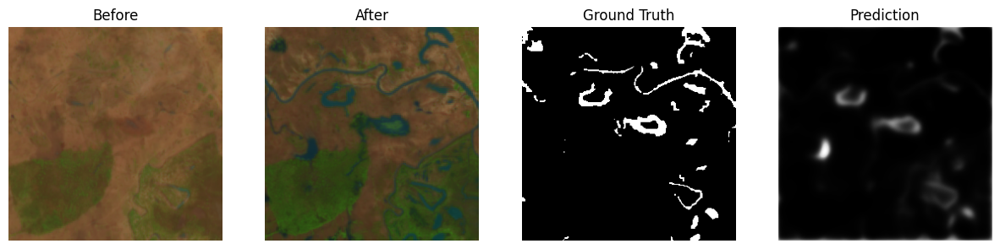

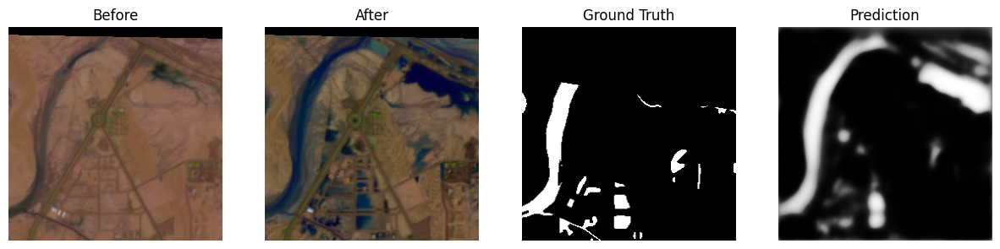

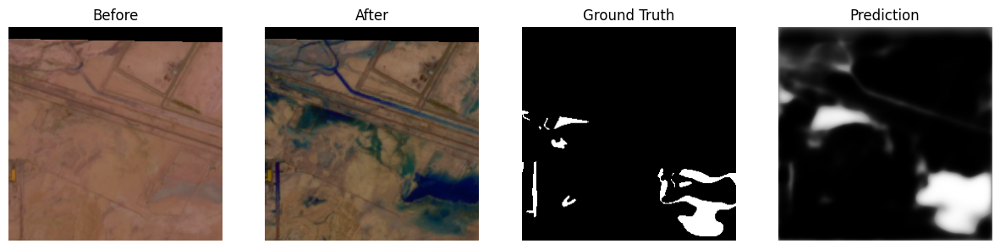

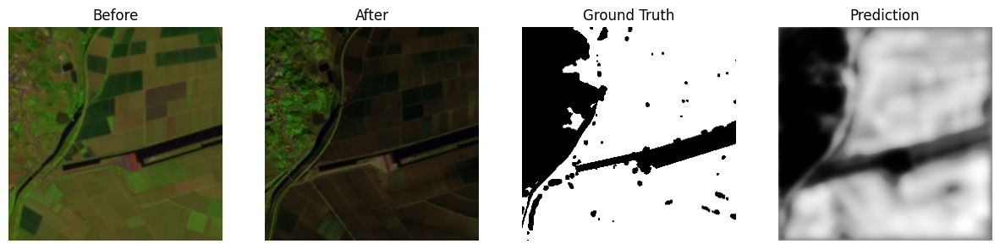

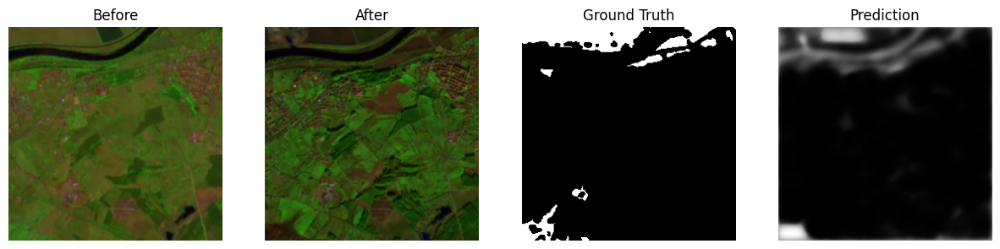

...

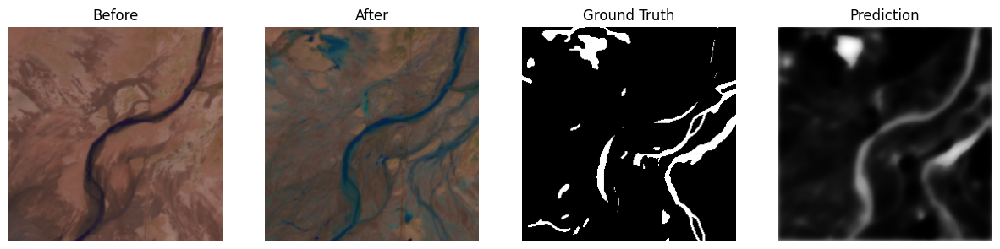

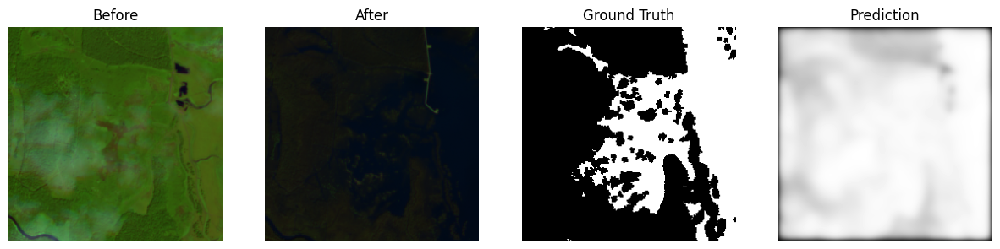

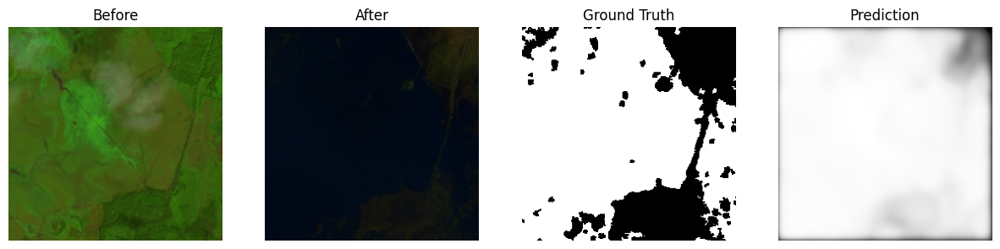

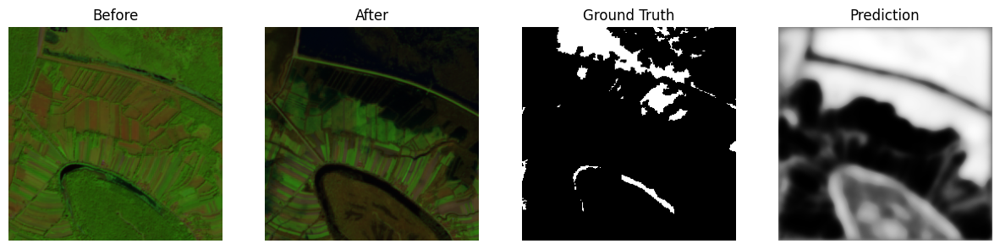

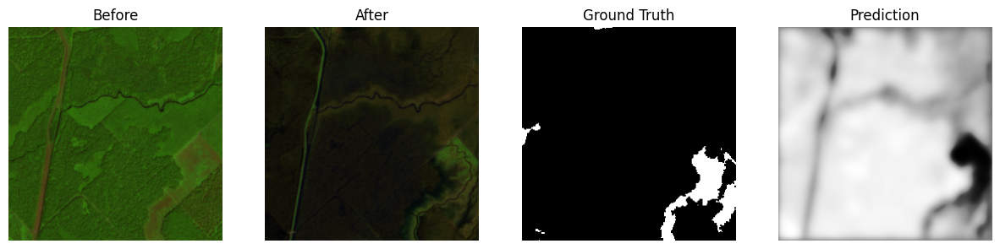

In [ ]:
import matplotlib.pyplot as plt

# Evaluate the model on the test set
results = model.evaluate(X_test_full, Y_test_full, verbose=1)
print("Test loss:", results[0])
print("Test accuracy:", results[1])
print("Test Mean IoU:", results[2])
print("Test Dice Coefficient:", results[3])
print("Test Precision:", results[4])
print("Test Recall:", results[5])

# Make predictions on the test set
predictions = model.predict(X_test_full)

# Function to visualize results
def visualize_predictions(X_test, Y_test, predictions, num_samples=5):
    for i in range(num_samples):
        plt.figure(figsize=(15, 5))

        # Original 'before' image
        plt.subplot(1, 4, 1)
        plt.title("Before")
        plt.imshow(X_test[i, :, :, :3])  # Assuming 'before' images are the first 3 channels
        plt.axis('off')

        # Original 'after' image
        plt.subplot(1, 4, 2)
        plt.title("After")
        plt.imshow(X_test[i, :, :, 3:6])  # Assuming 'after' images are the next 3 channels
        plt.axis('off')

        # Ground truth mask
        plt.subplot(1, 4, 3)
        plt.title("Ground Truth")
        plt.imshow(Y_test[i, :, :, 0], cmap='gray')
        plt.axis('off')

        # Predicted mask
        plt.subplot(1, 4, 4)
        plt.title("Prediction")
        plt.imshow(predictions[i, :, :, 0], cmap='gray')
        plt.axis('off')

        plt.show()

# Visualize predictions for a few samples
visualize_predictions(X_test_full, Y_test_full, predictions, num_samples=30)
